In [3]:
import sys
import os
import time
import pandas as pd
# Importing the main code.
module_path = os.path.abspath(os.path.join('../src/ocloc'))
if module_path not in sys.path:
    sys.path.append(module_path)
from ocloc import ProcessingParameters, ClockDrift

# OCloC Python Package - Implementation

In order to detect and correct timing errors using ambient noise seismic inteferometry, we developed an algorithm that follows the processing sheme shown in figure . The functional workflow comprises five main processing steps: Interferometric response retrieval, data filtering, time-symmetry shift measurement, time-symmetry verification, construction of the linear system of equations, and results refinement and verification. 



## Step 1: Loading the interferometric responses

Given that Github has a limited capacity to upload data, please request the dataset to David Naranjo (d.f.naranjohernandez@tudelft.nl).
Then, change the path2datadir variable to the location of this folder in your computer.

In [4]:
# Parameters for locating the files where the correlation files and station 
# information is contained.
path2data_dir = "/Users/localadmin/Dropbox/GitHub/data"
#path2data_dir = "/Users/davidnaranjohernandez/Dropbox/GitHub/data"

Then we indicate the station_file which contains the metadata of our stations. By using Pandas we can check the first 5 rows of this file. This is a csv file with a header.

In [5]:
# Firts five rows of the station_info file using pandas.
import pandas as pd
station_file = "station_info"
df = pd.read_csv(station_file, delim_whitespace=True)
display(df.head(2))
display(df.tail(3))

,PROJECT,SENSORCODE,needs_correction(True/False),LATITUDE,LONGITUDE,ELEVATION(m),SENSORTYPE
0,IMAGE,O01,True,63.78344,-22.01142,-106.0,PZ_OBS
1,IMAGE,O02,True,63.78321,-22.22867,-100.0,PZ_OBS


,PROJECT,SENSORCODE,needs_correction(True/False),LATITUDE,LONGITUDE,ELEVATION(m),SENSORTYPE
44,IMAGE,STK,False,63.899571,-22.697866,88.0,PZ_MARKSENSOR
45,IMAGE,ARN,False,63.862844,-22.046070,179.0,PZ_MARKSENSOR
46,IMAGE,MER,False,63.883236,-22.228253,194.0,PZ_MARKSENSOR


When adapting the station_file to your won needs it is very important to modify the column (needs_correction) as this will determine which stations are going to be checked and correct for timing errors. In this example we set this value as True for all the OBSs, but you can also set it to True for land stations.

In [6]:
# The reference time is zero time to which the dates of the correlations
# will be compared. It can be the date of deployment. 
reference_time = '2014-08-21T00:00:00.000000Z'

Then we proceed to load this information to the ClockDrift object. The ClockDrift object stores all the information of the different cross-correlations, station metadata and parameters used for processing the data. 
If there are no cross-correlations available for a given station, the program will let you know.

In [7]:
# Initialize the parameters that will be used to process al the correlation files.
processing_parameters = ProcessingParameters(
    freqmin = 0.15, # Low freq. for the bandpass filter
    freqmax = 0.3, # High freq. for the bandpass filter
    #...
    )

cd = ClockDrift(station_file, 
                 path2data_dir, 
                 reference_time, 
                 [processing_parameters])
print(cd)

No correlation file found for station:O26
ClockDrift object
There are 46 stations stored within the ClockDrift object. 
There are 2695 correlations stored within the ClockDrift object.



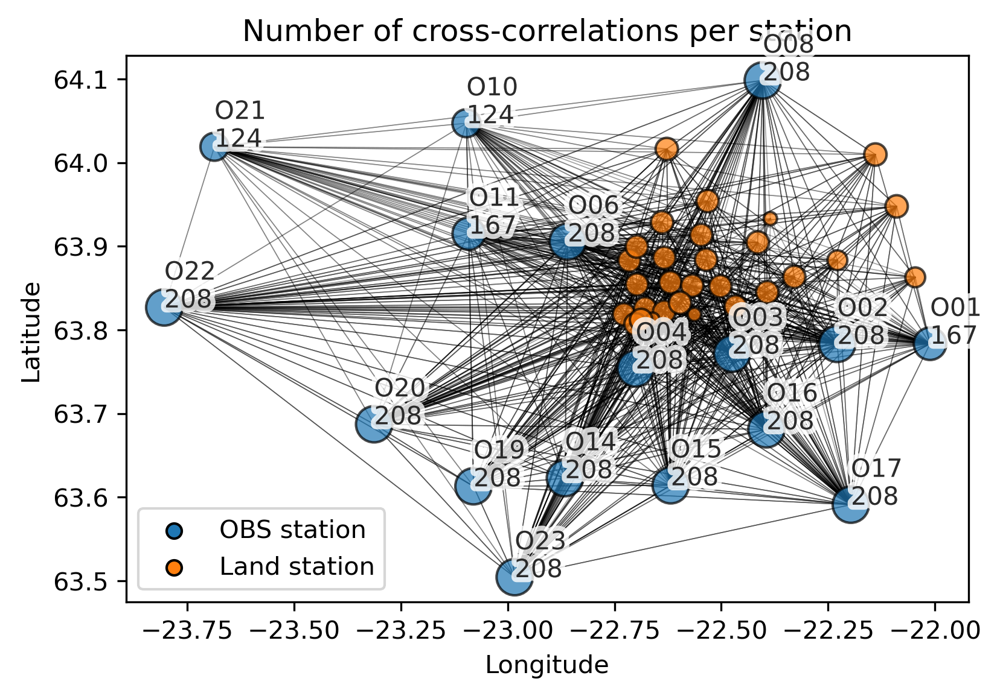

In [8]:
cd.plot_inventory_correlations()

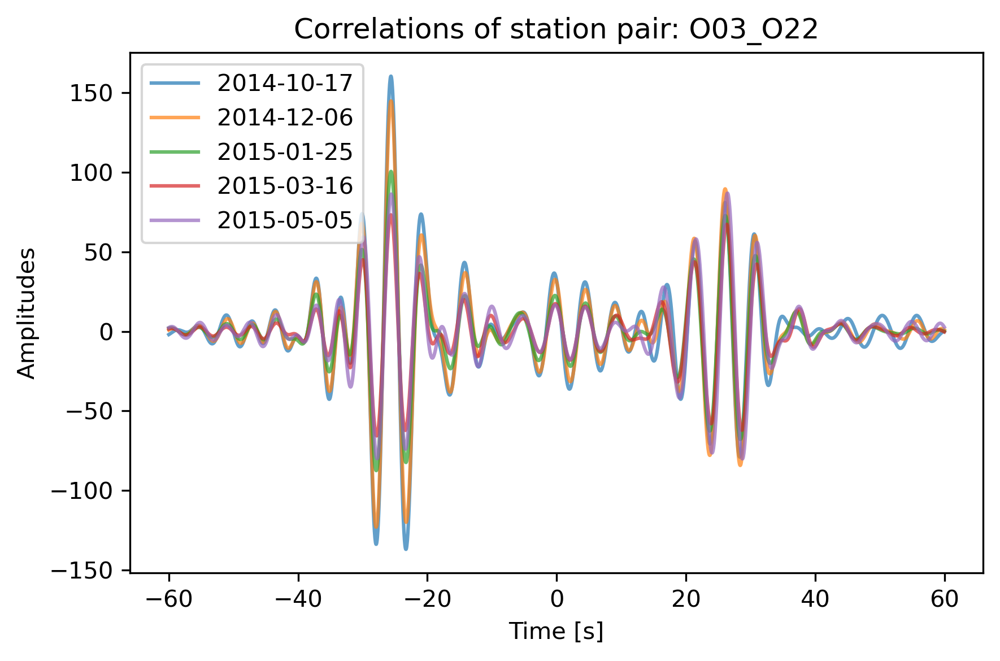

In [9]:
cd.plot_correlations_of_stationpair("O22", "O03", min_t=-60, max_t=60)

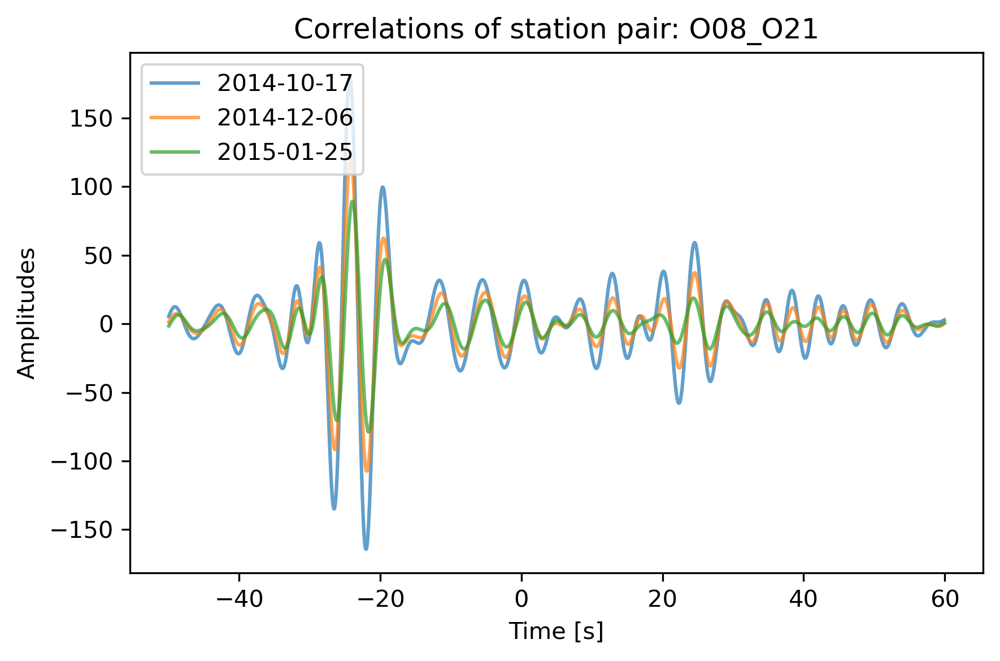

In [10]:
cd.plot_correlations_of_stationpair("O21", "O08", max_t=60)

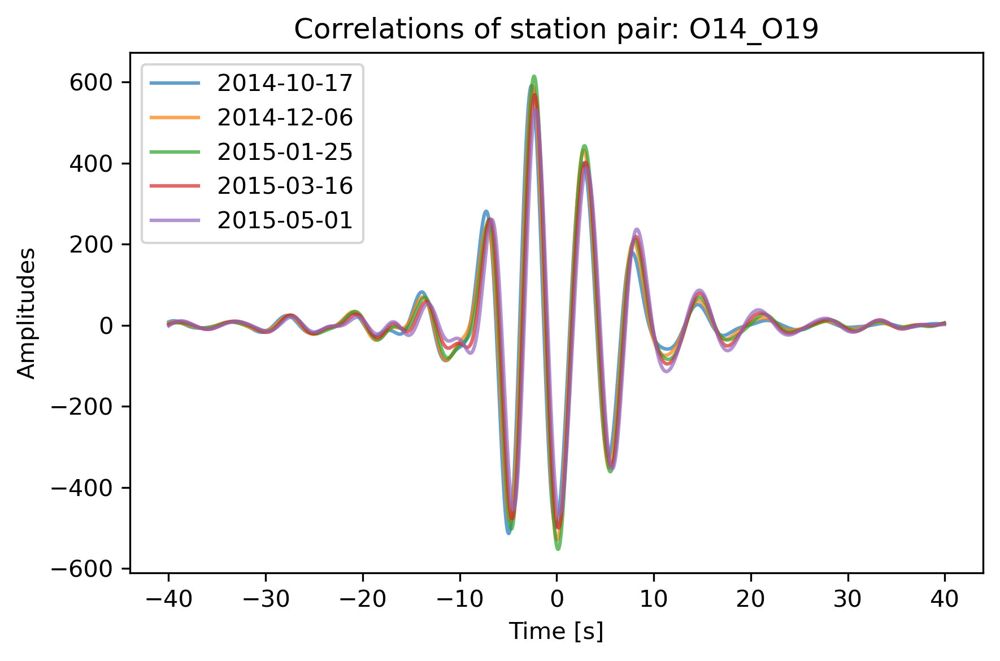

In [11]:
cd.plot_correlations_of_stationpair("O14", "O19", min_t=-40, max_t=40)

No correlation file found for station:O26
Calculating the apriori estimates for each stationpair
Calculating the t_app for each stationpair.
Calculating a and b for each station.


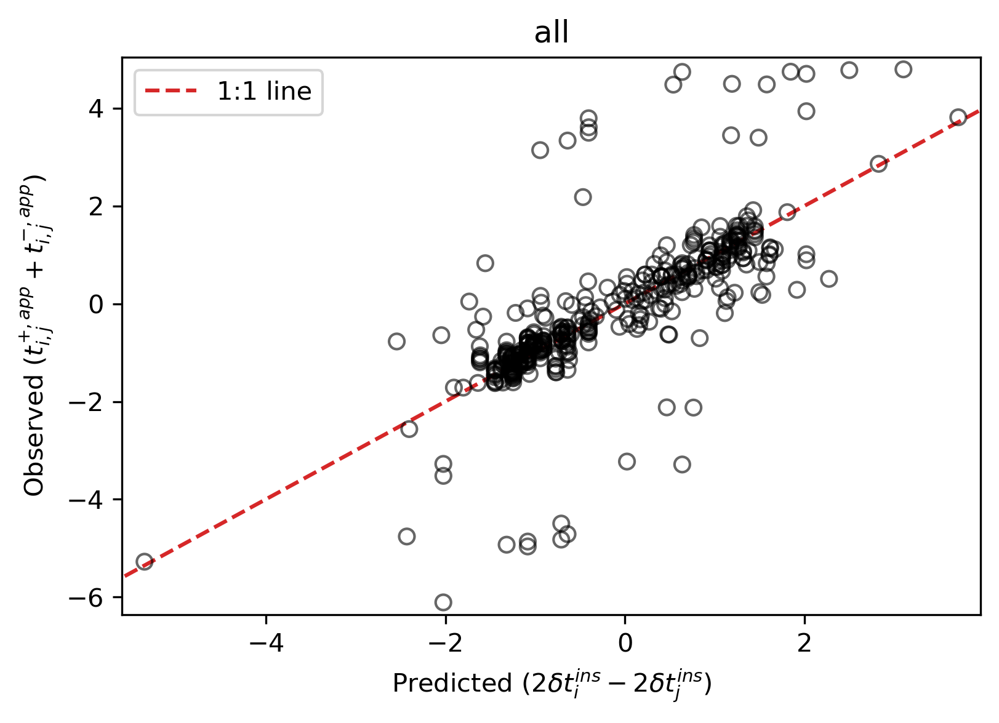

/Users/localadmin/opt/anaconda3/envs/obsrocko/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3420: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/localadmin/opt/anaconda3/envs/obsrocko/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


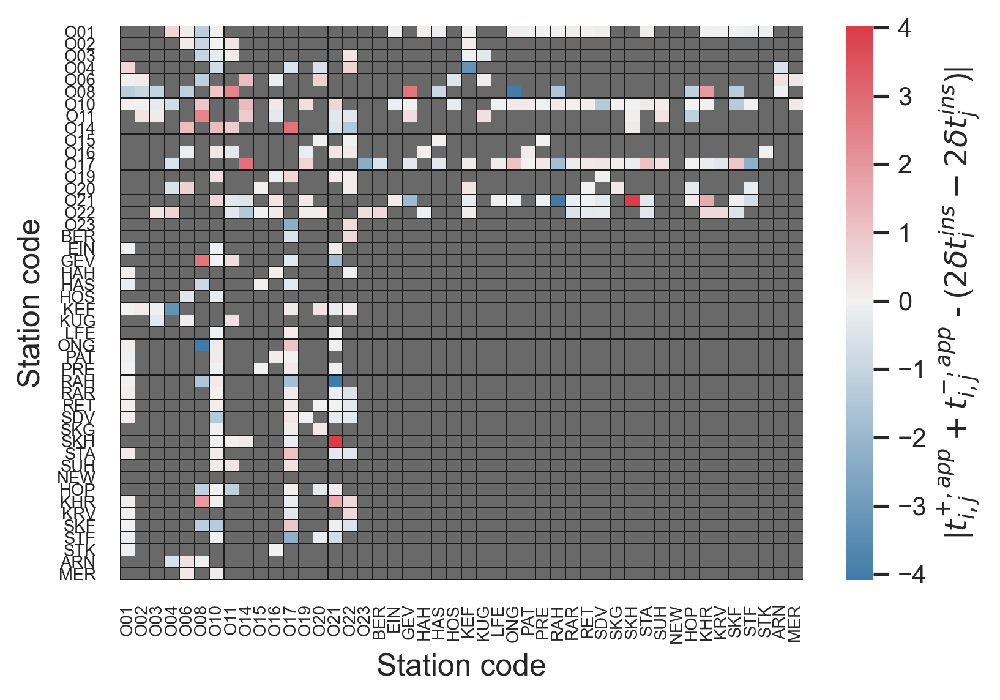

/Users/localadmin/opt/anaconda3/envs/obsrocko/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3420: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/localadmin/opt/anaconda3/envs/obsrocko/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


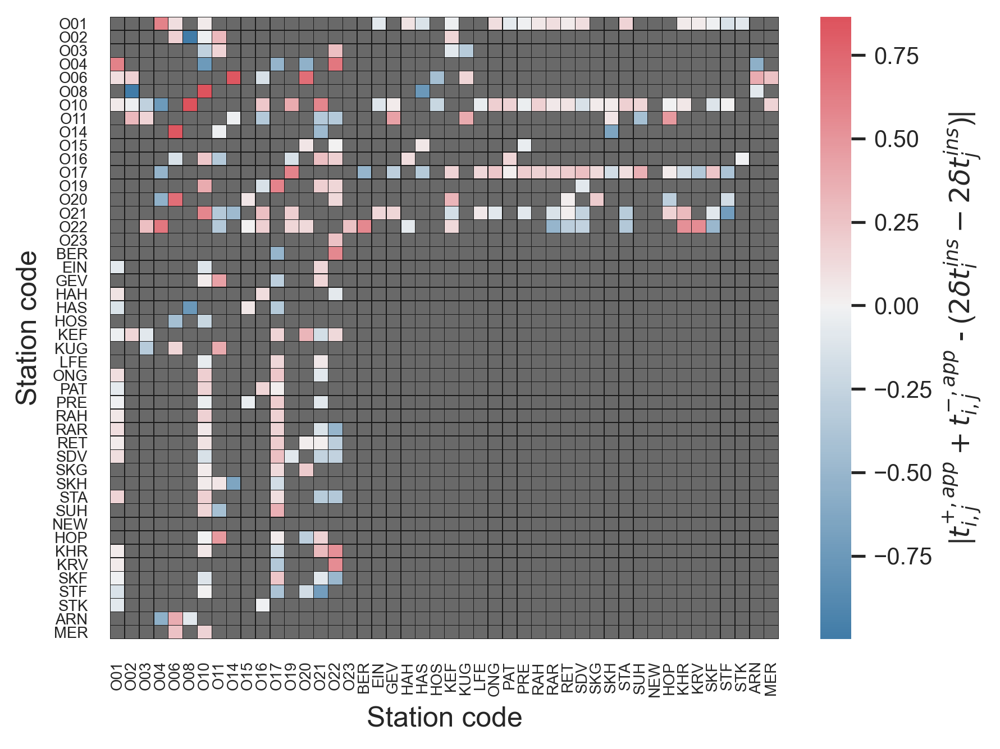

Calculating a and b for each station.


In [12]:
params2 = ProcessingParameters(
                 freqmin = 0.2, # Low freq. for the bandpass filter
                 freqmax = 0.4, # High freq. for the bandpass filter 
                 ref_vel = 4500, # m/s
                 dist_trh = 2.5, # Minimum station separation in terms of wavelength
                 snr_trh = 30, # Signal-to-noise ratio threshold
                 noise_st = 240, # start of the noise window.
                 dt_err = 0.004, # Sampling interval needs to be multiple of this value.
                 resp_details = False)

cd = ClockDrift(station_file, path2data_dir, 
                  reference_time = '2014-08-21T00:00:00.000000Z',
                  list_of_processing_parameters=[params2])#, params3])
        
        
cd.calculate_aprioridt_4_allcorrelations_corrected()
cd.calculate_dt_ins()
cd.calculate_tapp_4_allcorrelations()
cd.build_matrices()
cd.solve_eq()
cd.plot_observed_vs_predicted()
cd.plot_matrix_diff_observed_predicted()
cd.remove_outiers(max_error=1.)
cd.calculate_dt_ins()
cd.plot_matrix_diff_observed_predicted()
cd.build_matrices()
cd.solve_eq()

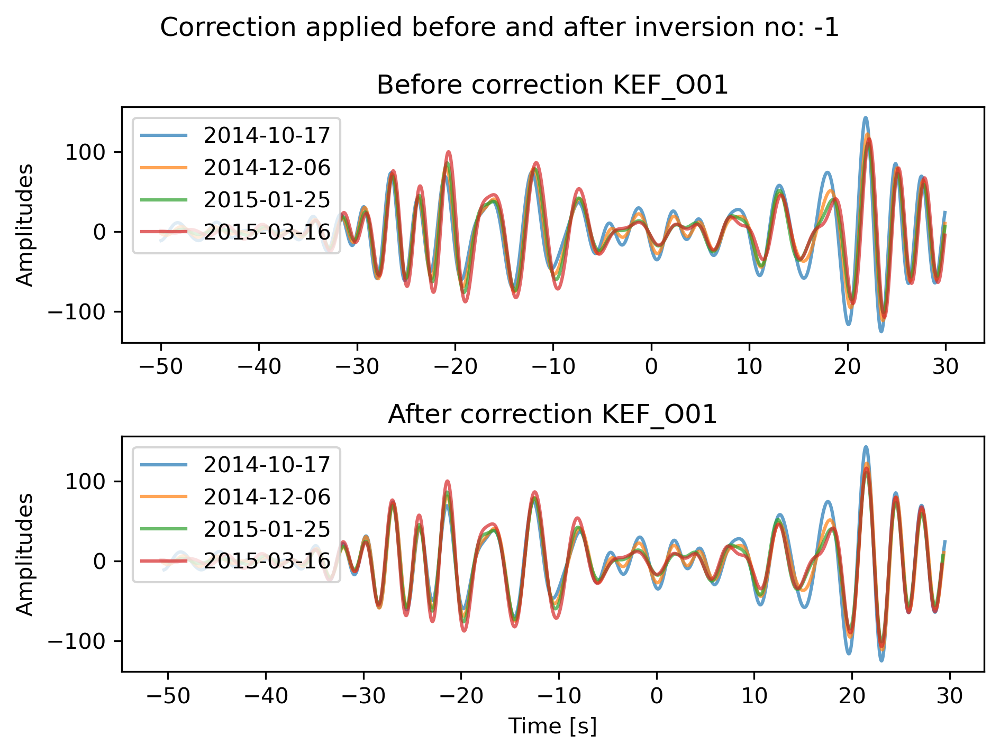

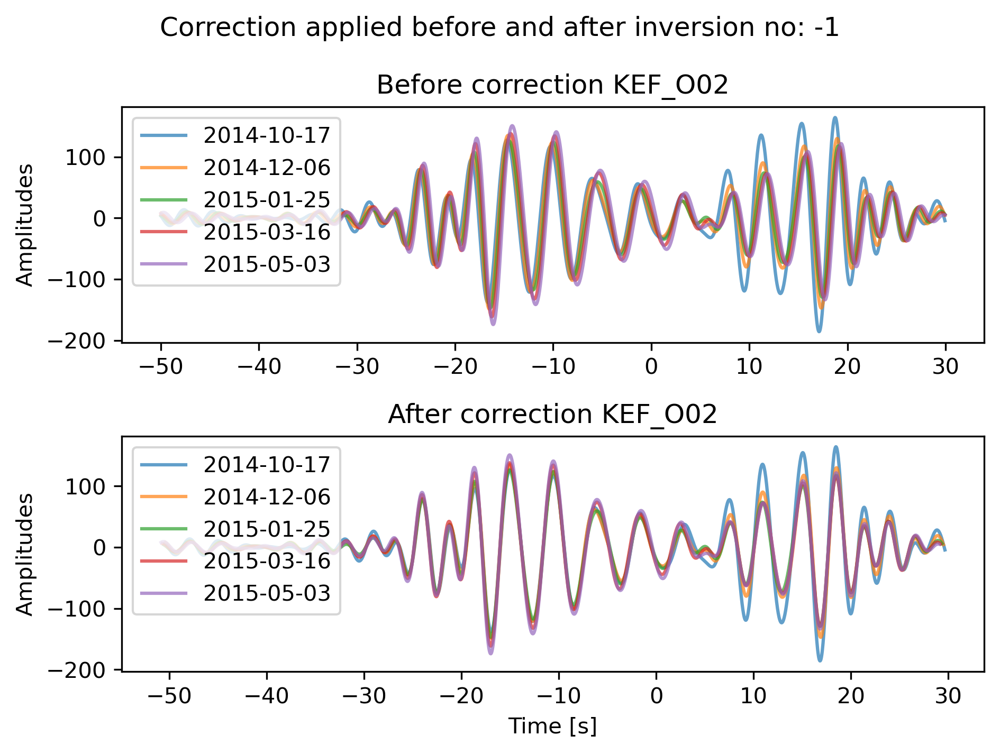

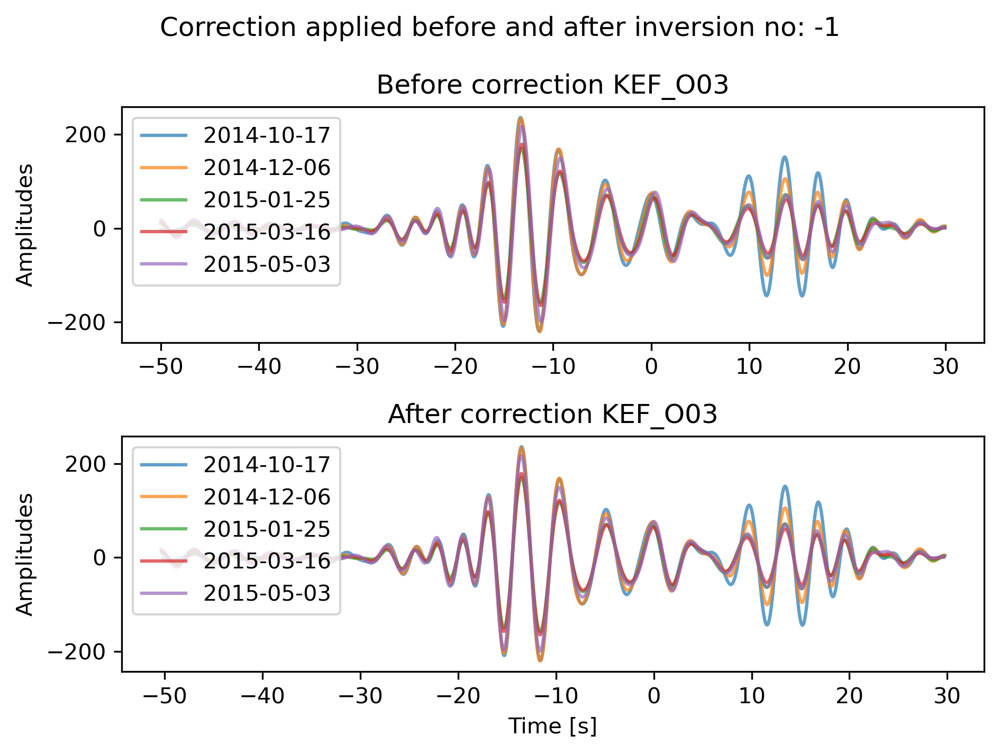

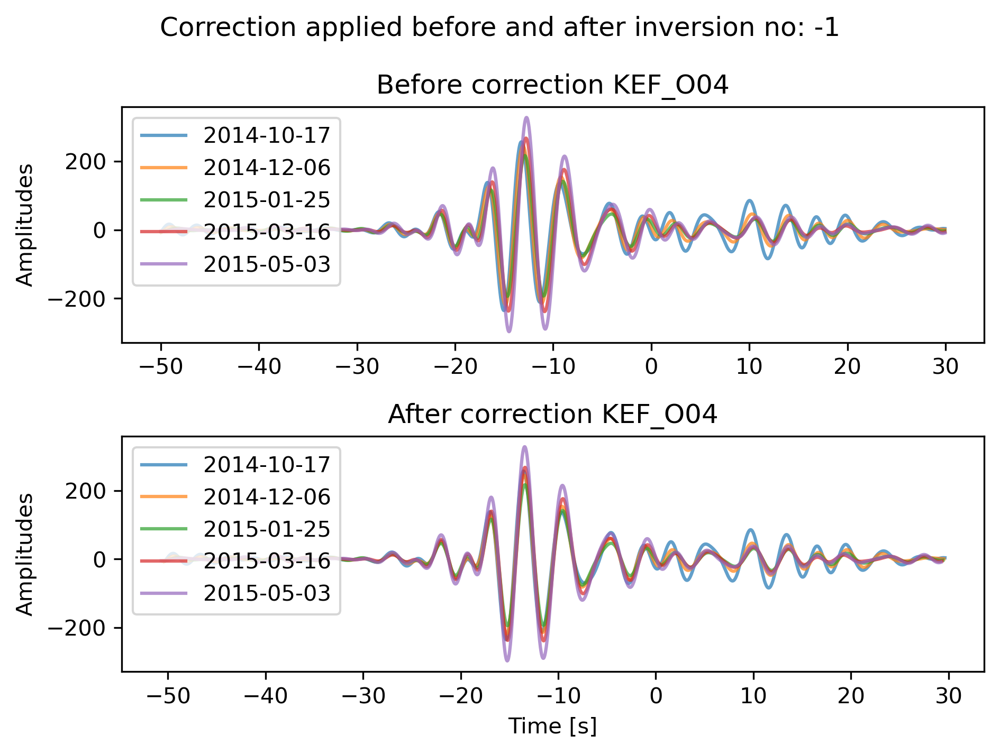

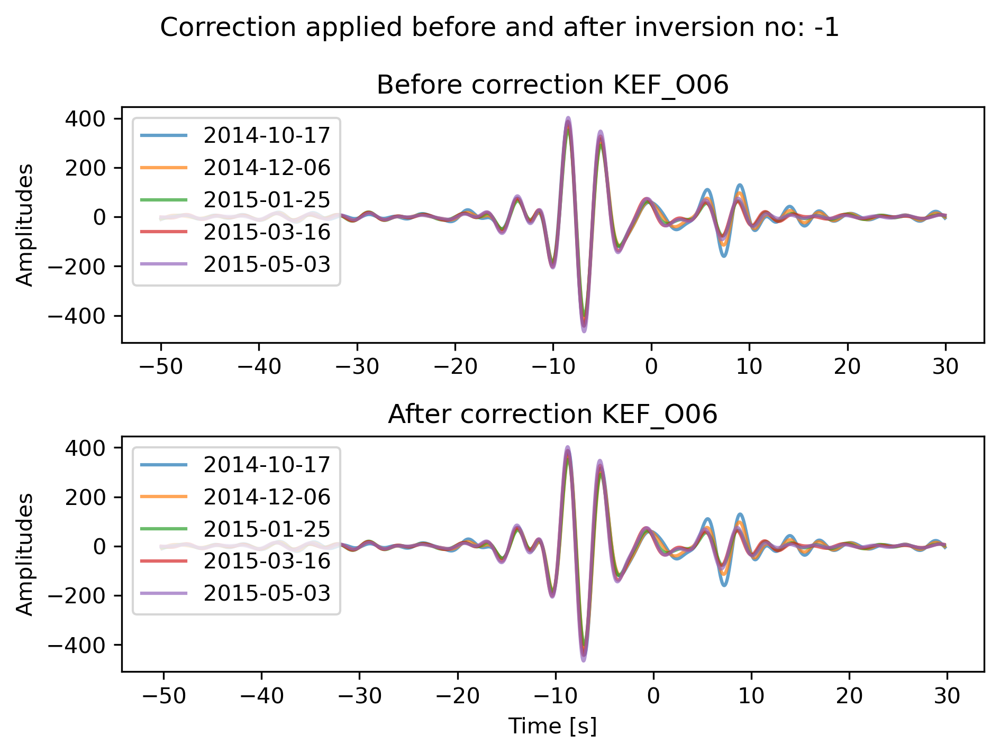

...

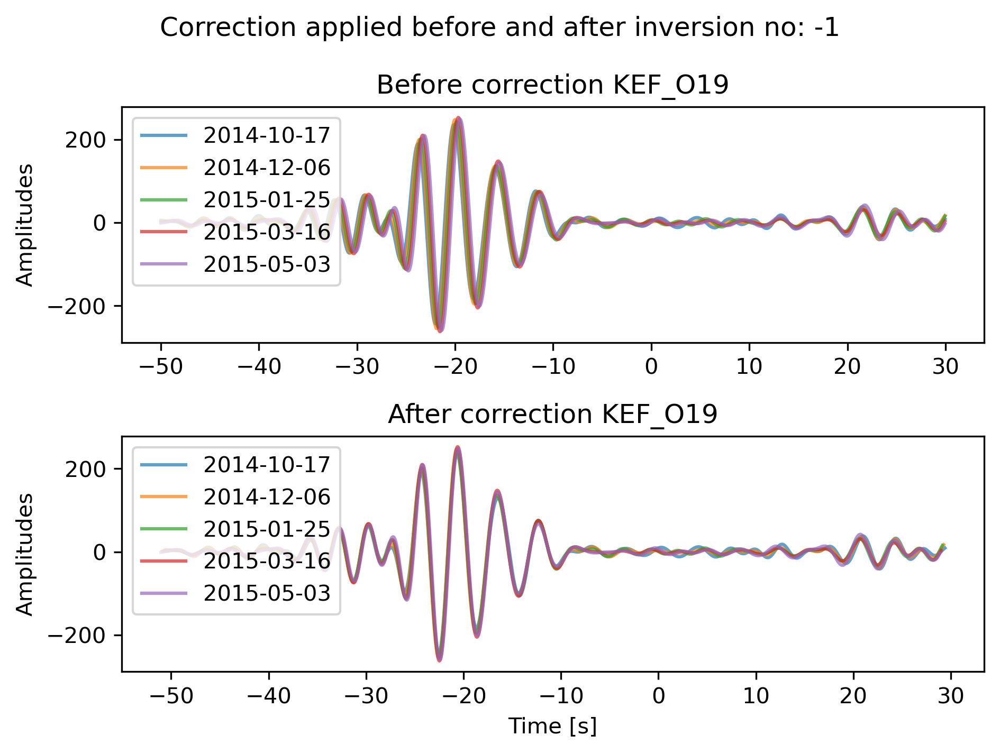

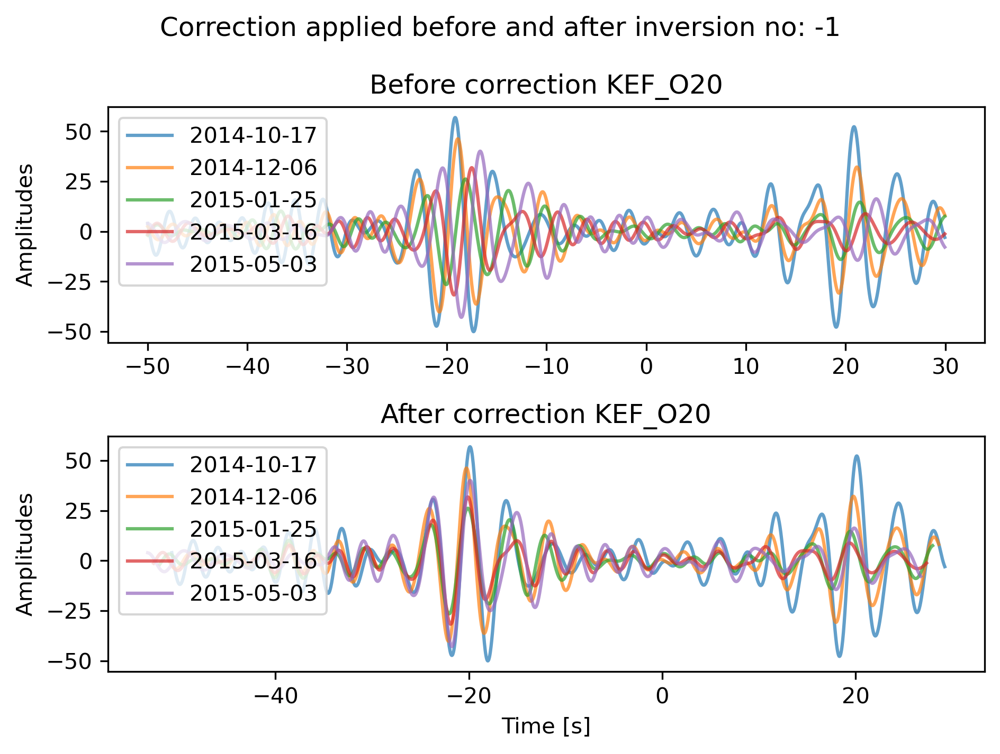

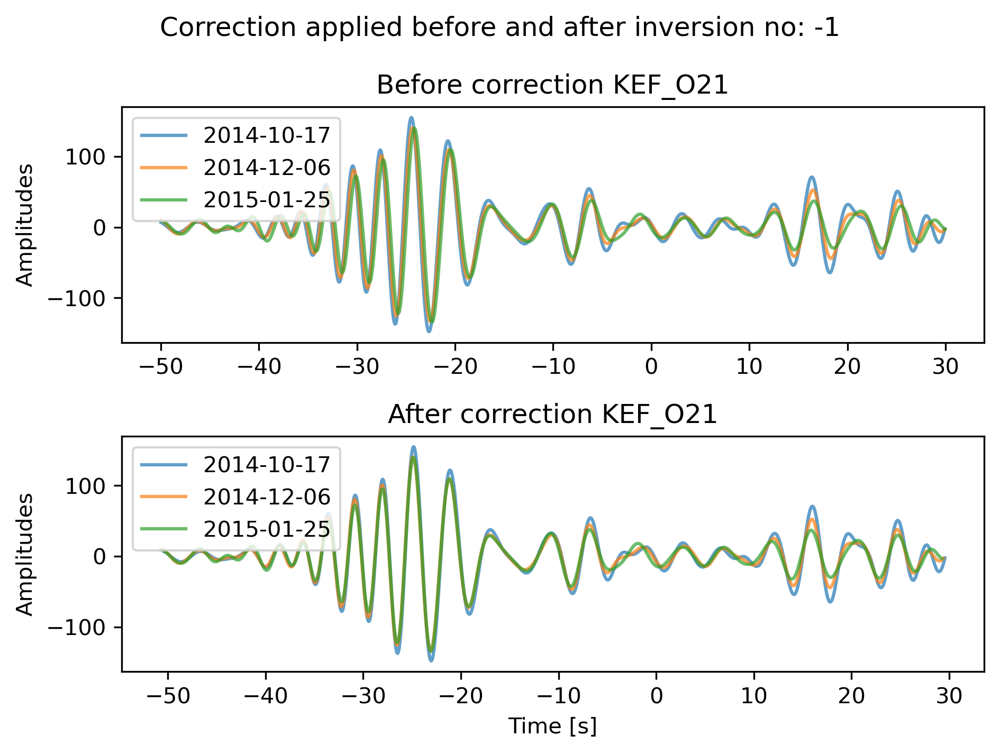

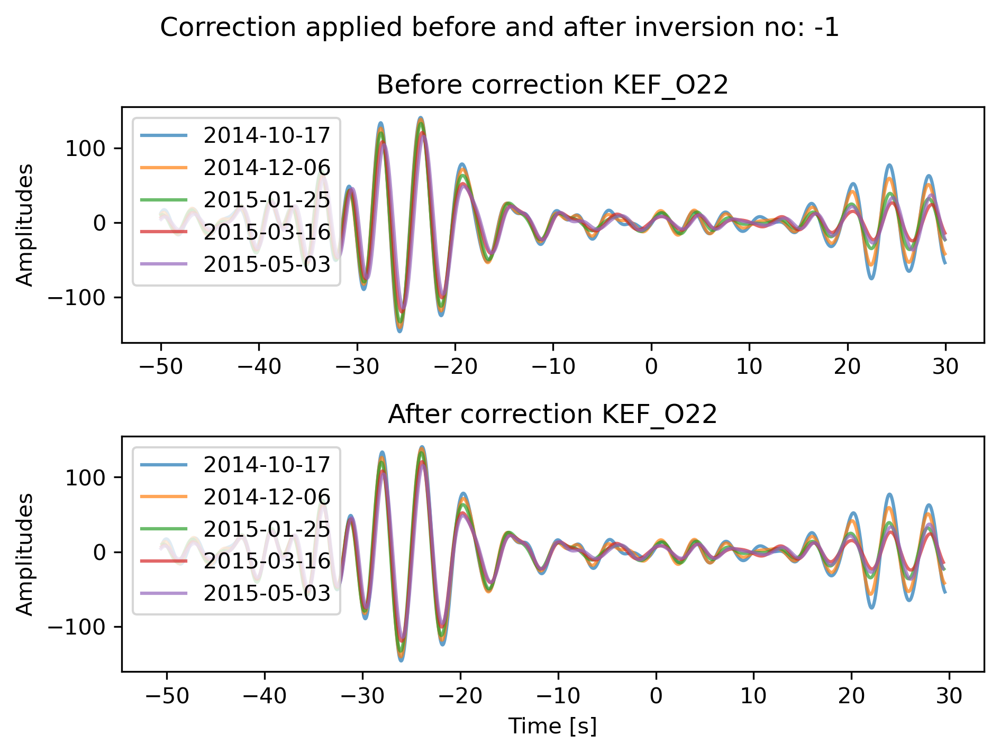

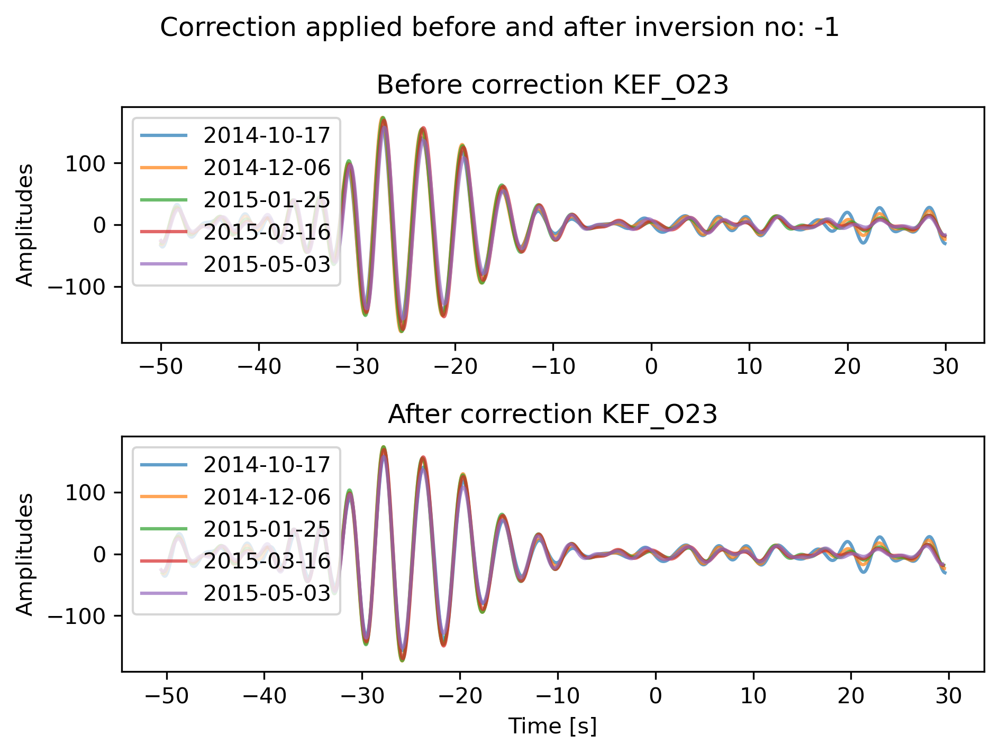

In [13]:
station1_code, station2_code = "O01", "KEF"
for sta in cd.stations:
    if sta.needs_correction:
        cd.plot_correlation_beforeNafter_correction(sta.code, station2_code)

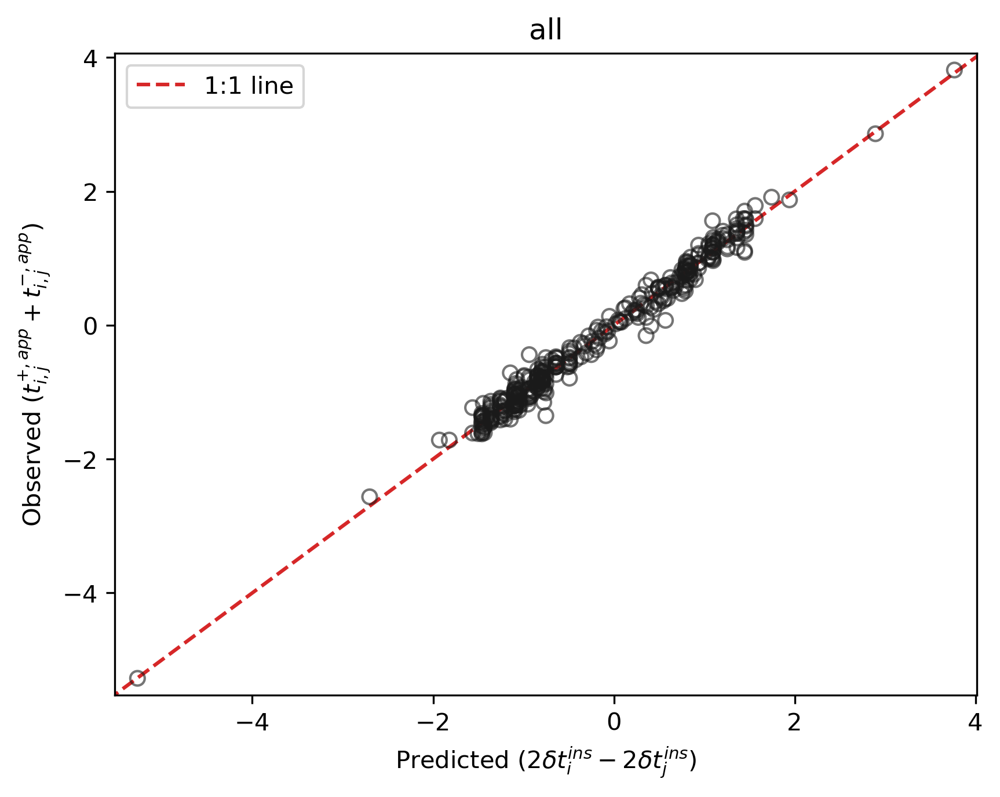

In [14]:
cd.plot_observed_vs_predicted()

/Users/localadmin/opt/anaconda3/envs/obsrocko/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3420: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/localadmin/opt/anaconda3/envs/obsrocko/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


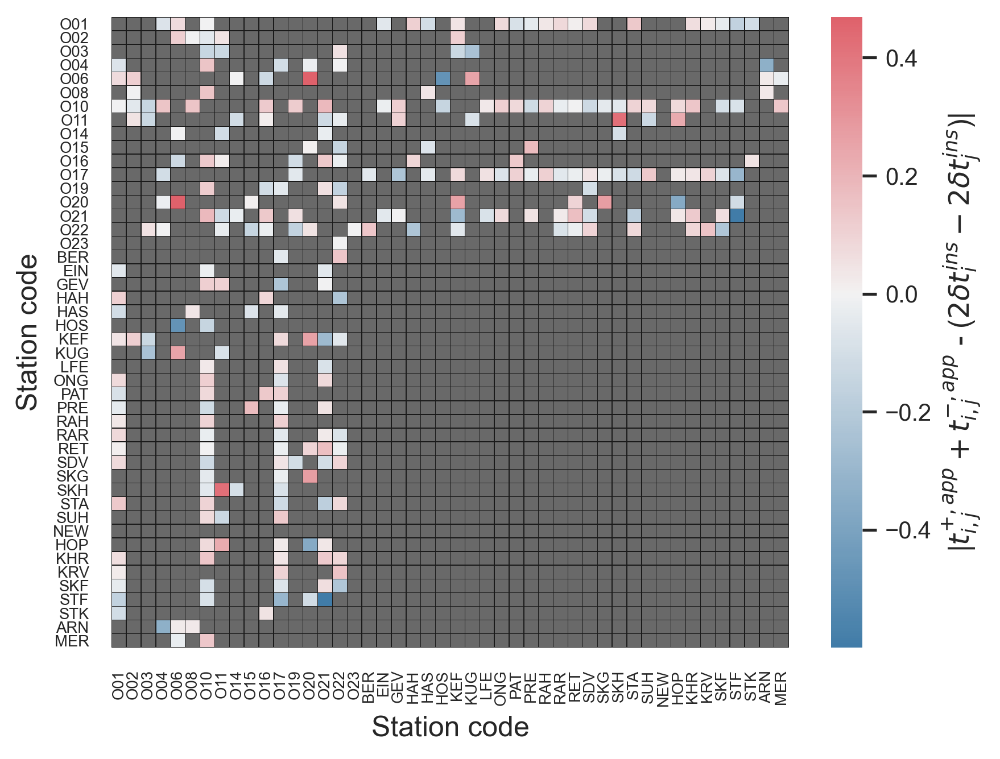

In [15]:
cd.plot_matrix_diff_observed_predicted()

# Convergence
We can run several inversions until the a and b valuesstop changing.

In [16]:
for i in range(4):
    cd.calculate_tapp_4_allcorrelations()
    cd.calculate_dt_ins()
    cd.remove_outiers(max_error=1.)
    cd.calculate_dt_ins()
    cd.build_matrices()
    cd.solve_eq()

Calculating the t_app for each stationpair.
Calculating a and b for each station.
Calculating the t_app for each stationpair.
Calculating a and b for each station.
Calculating the t_app for each stationpair.
Calculating a and b for each station.
Calculating the t_app for each stationpair.
Calculating a and b for each station.


No handles with labels found to put in legend.


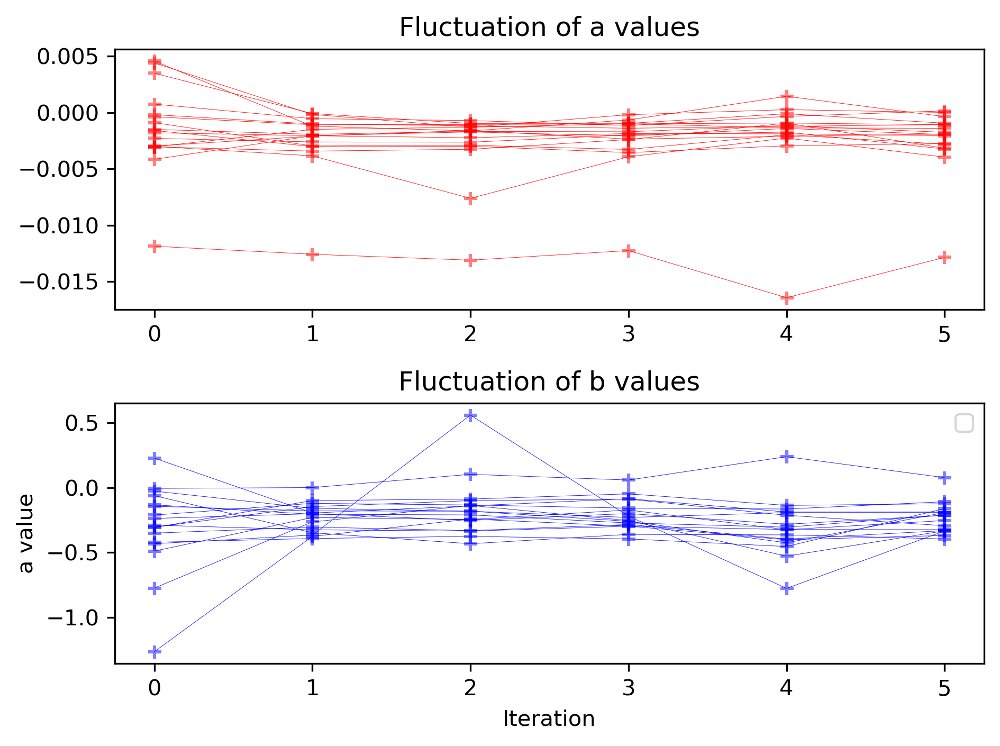

In [17]:
cd.plot_fluctuation_of_a_and_b()

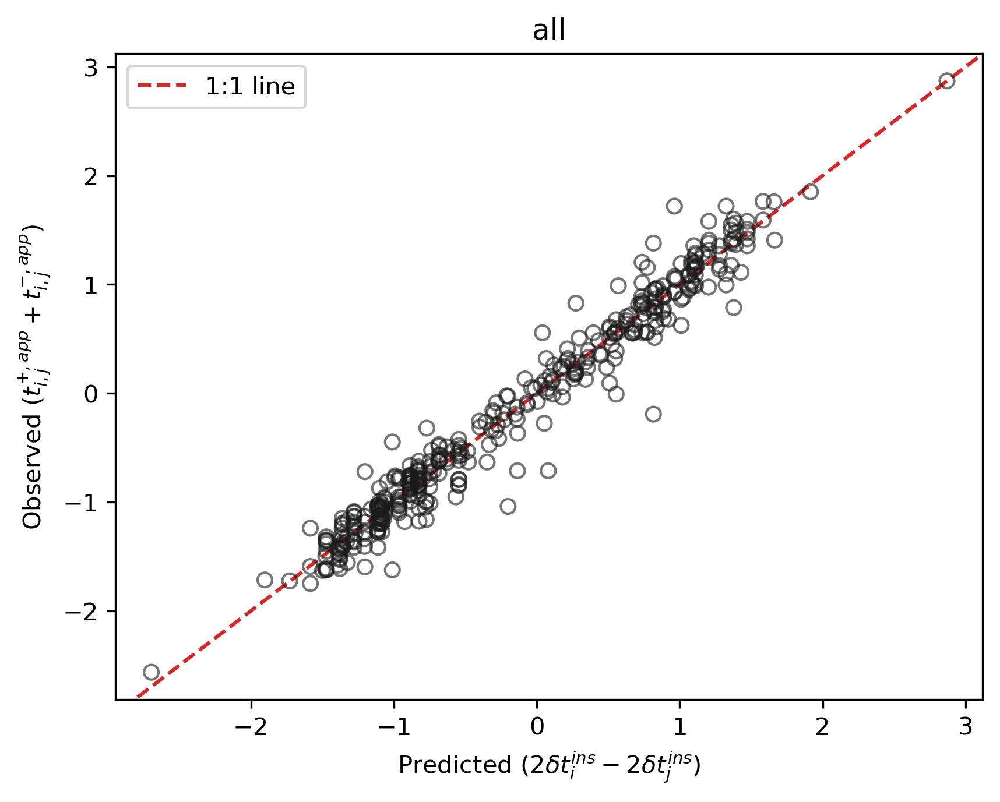

In [18]:
cd.plot_observed_vs_predicted()

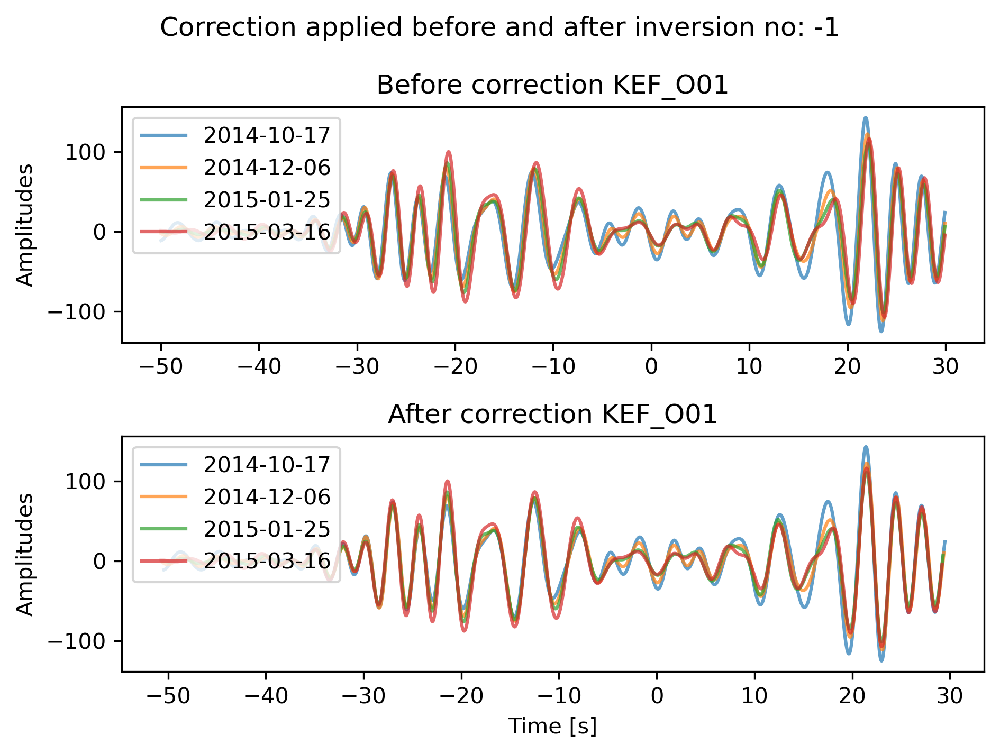

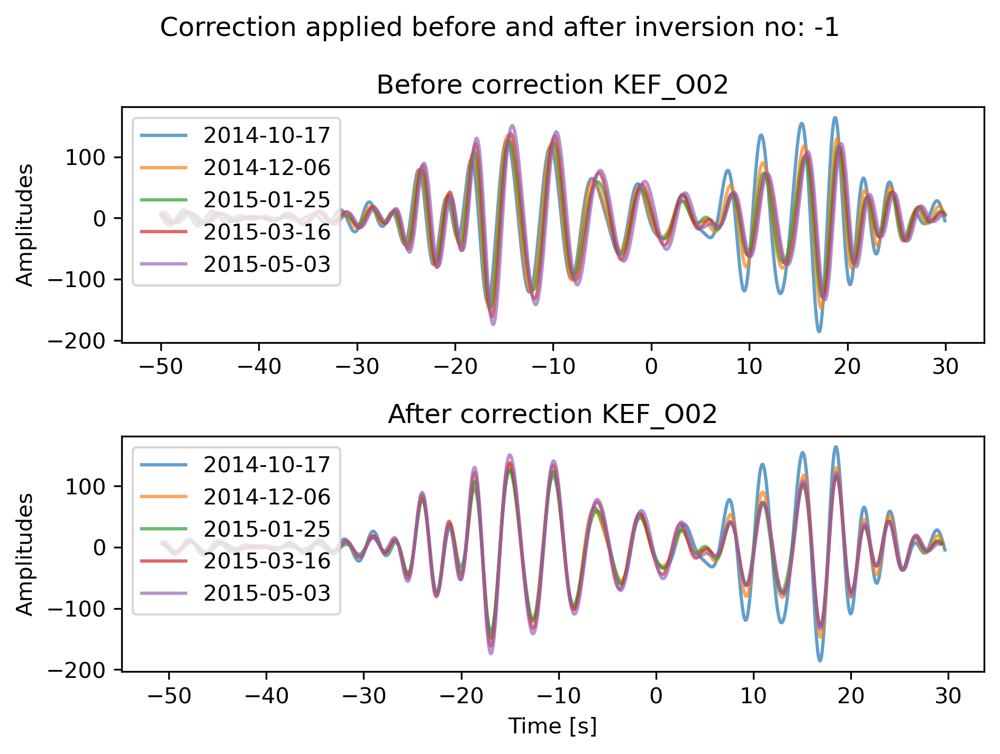

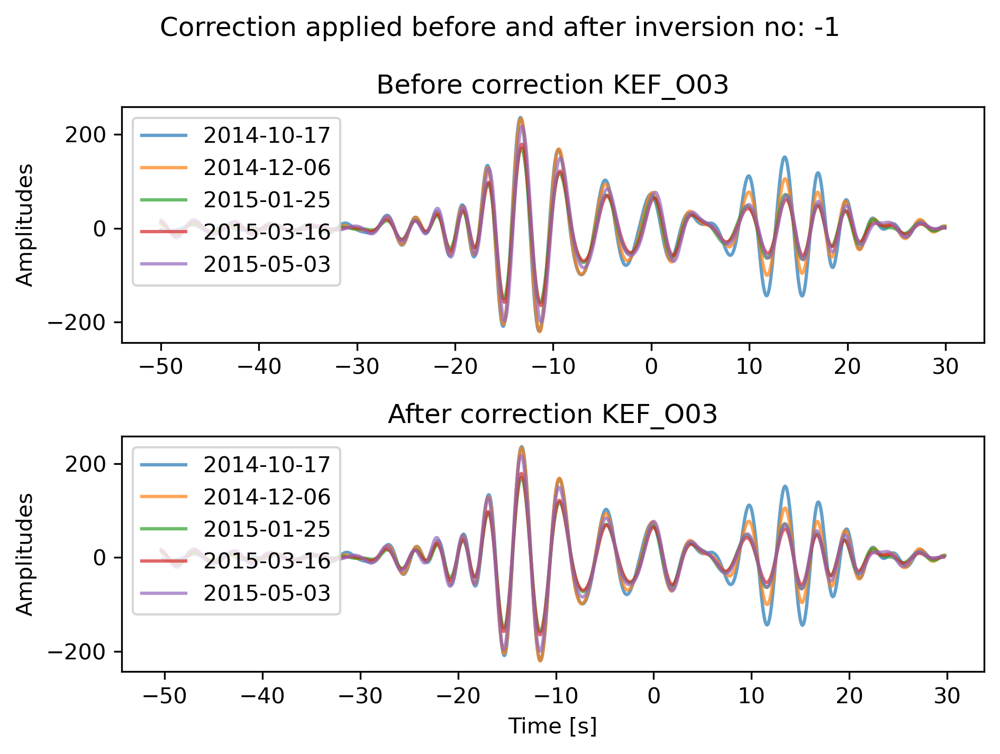

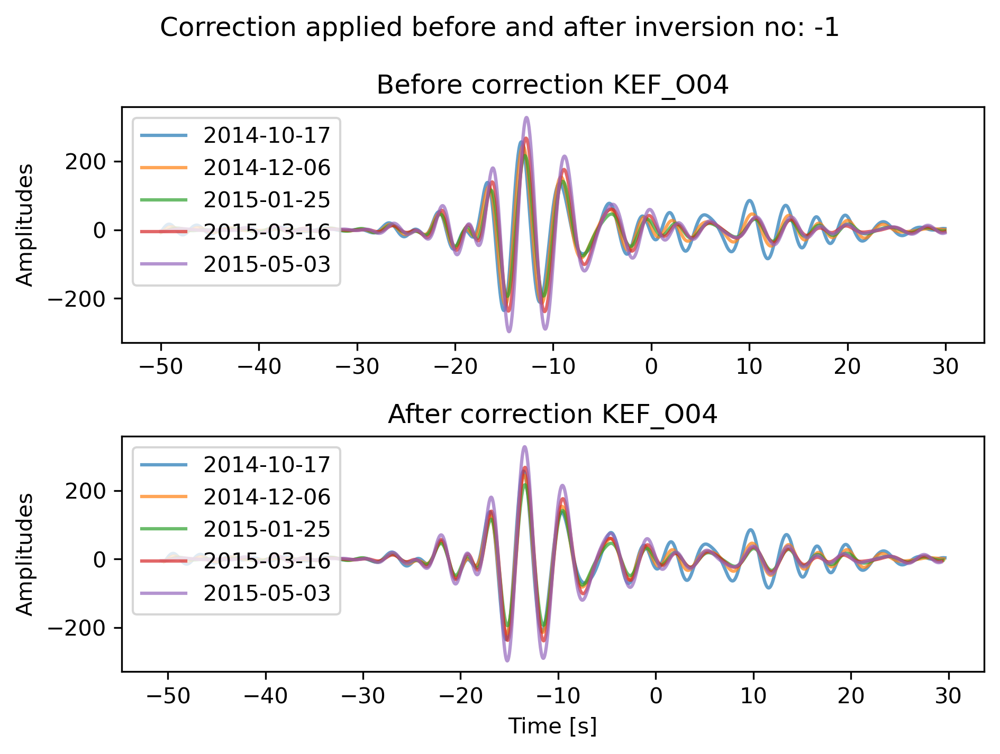

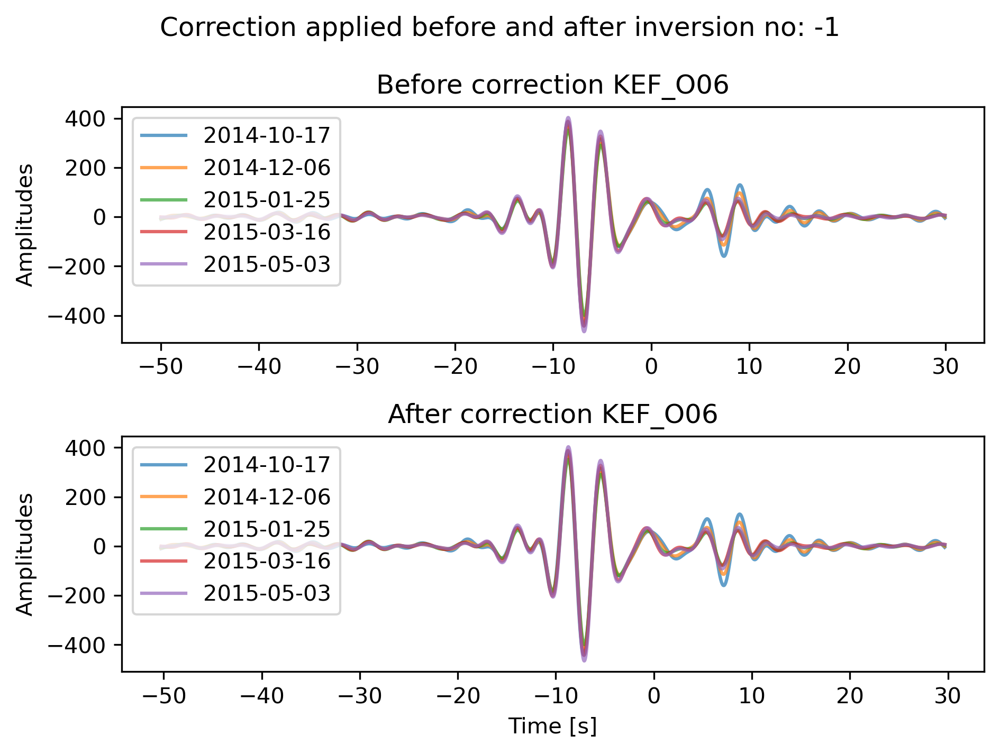

...

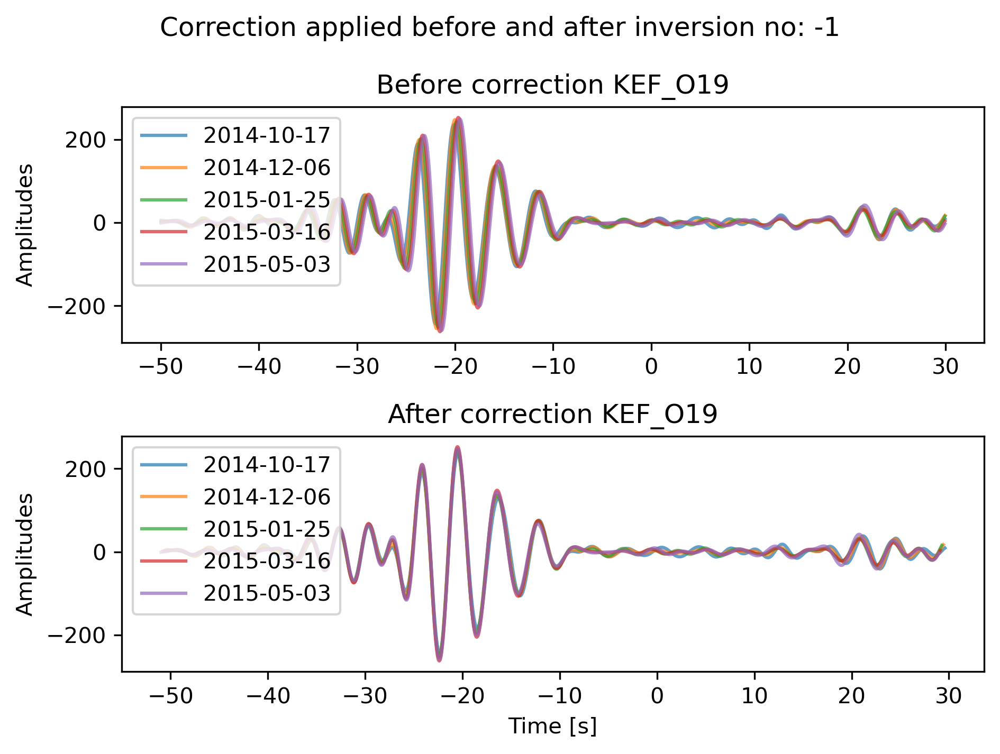

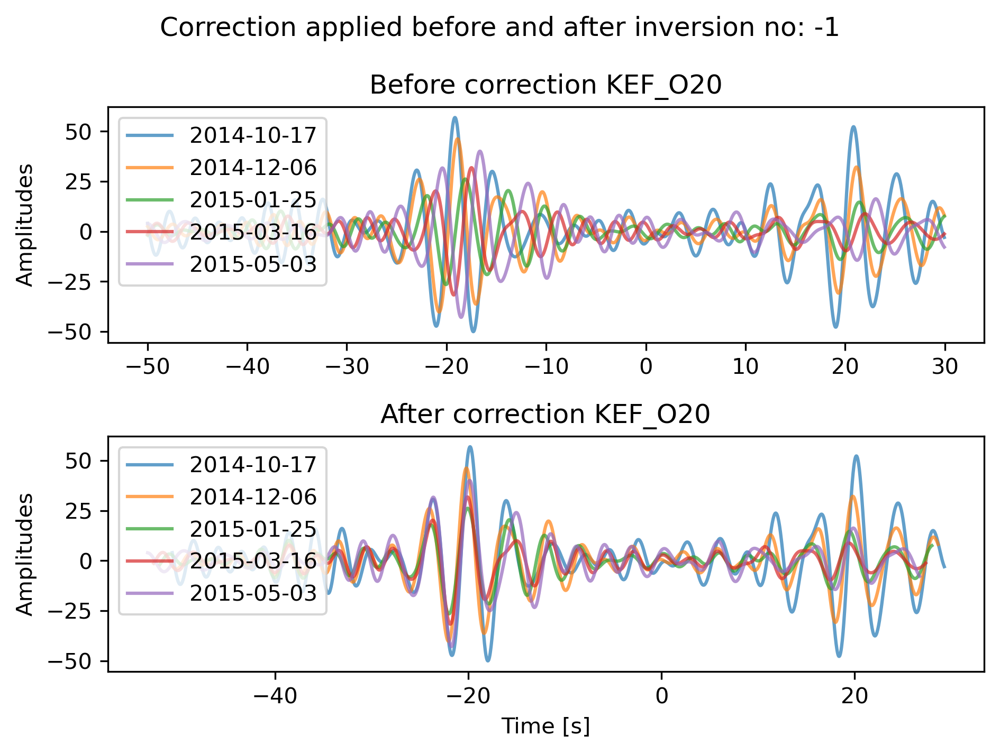

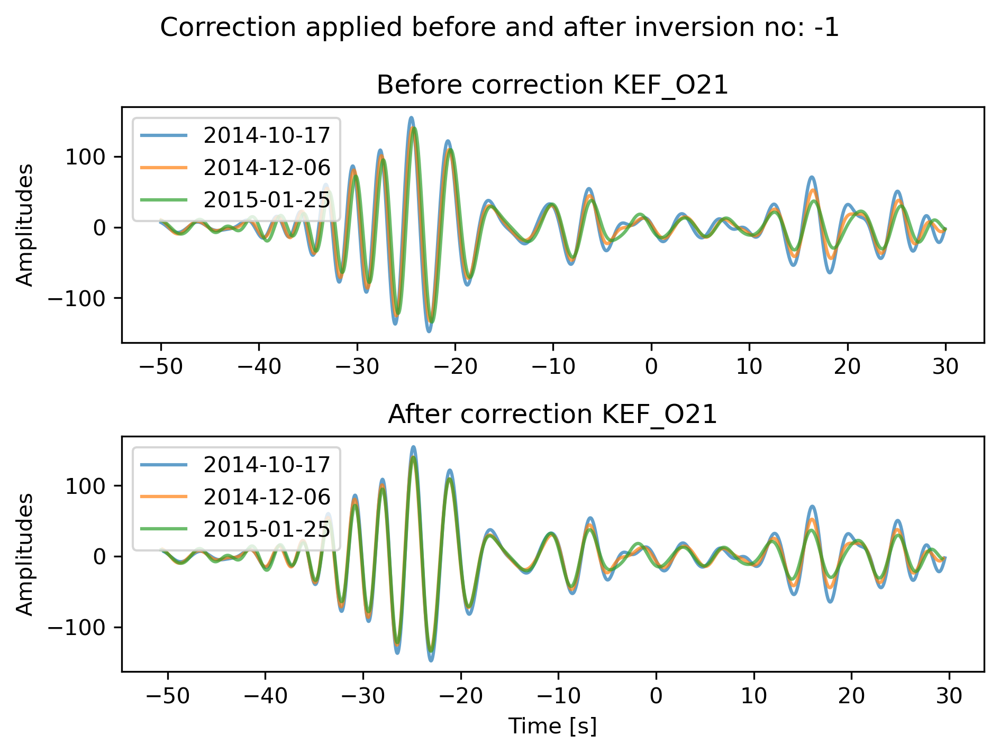

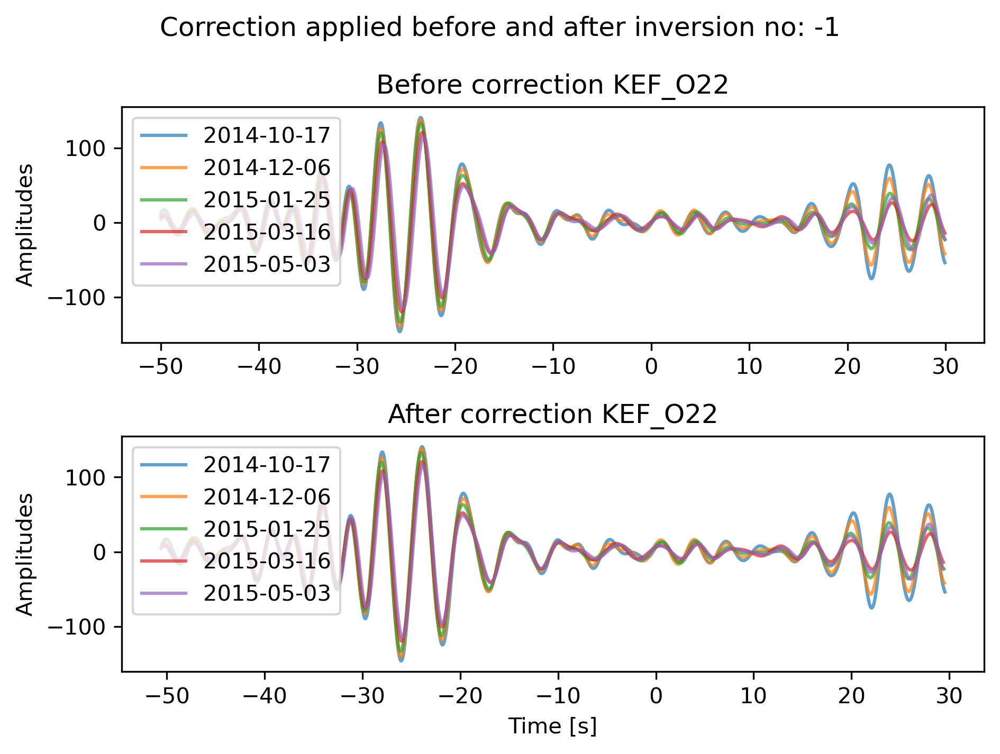

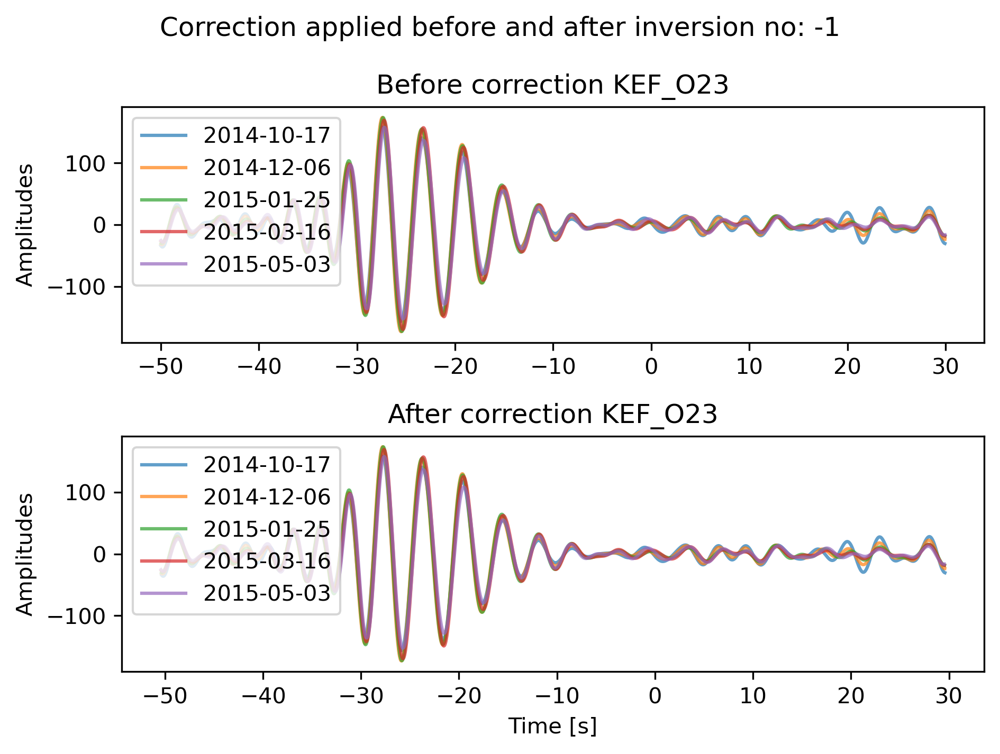

In [19]:
station2_code = "KEF"
for sta in cd.stations:
    if sta.needs_correction:
        cd.plot_correlation_beforeNafter_correction(sta.code, station2_code)

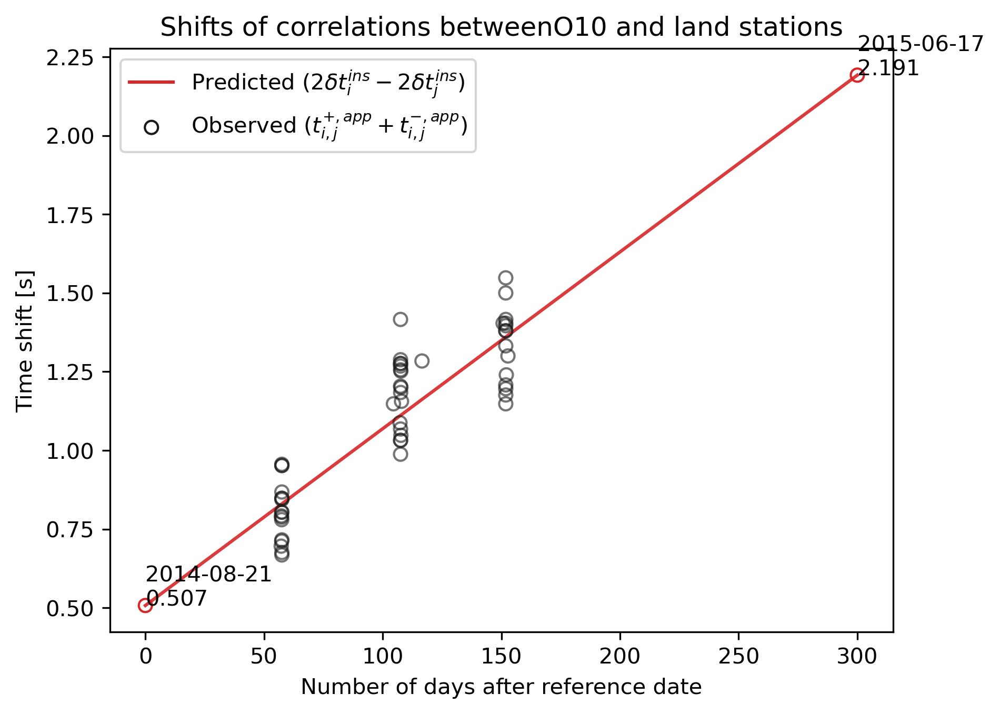

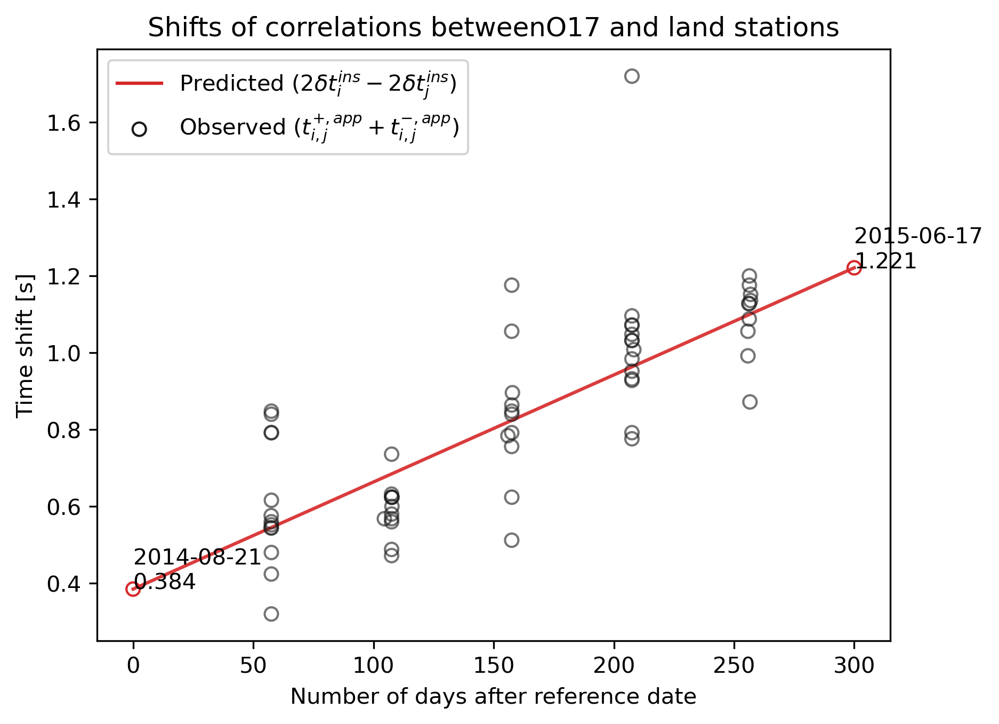

In [20]:
cd.plot_obs_and_pred_shifts_with_land_stations("O10")
cd.plot_obs_and_pred_shifts_with_land_stations("O17")

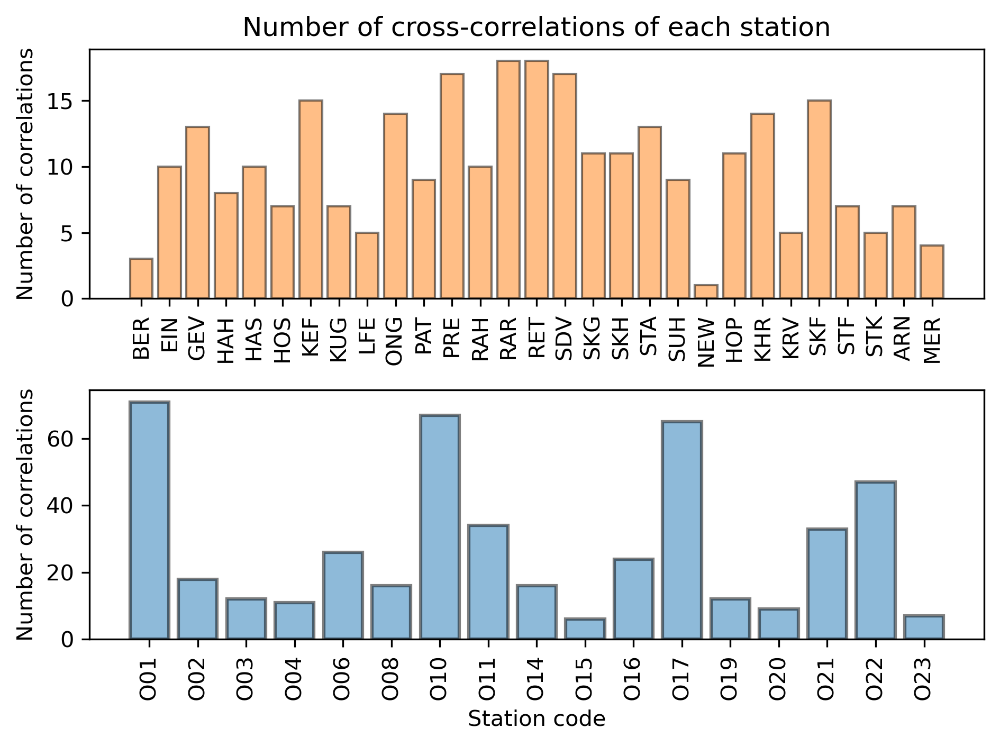

In [21]:
cd.plot_hist_no_correlations_per_station()

# Results

Having the a (clock drift rate) and b (incurred timing error at t=0) values it is possible to calculate if there is a time shift while the OBS is sinking. For calculating it is necessary to have the initial dates when the OBS started recording.

In [22]:
import pandas as pd
import obspy
import numpy as np
skew_values_file = "skew_values.csv"
path2file_skew = os.path.join(module_path, skew_values_file)
skew_df = pd.read_csv(path2file_skew, delimiter=",", header=0)
display(skew_df)

,Sensor code,Latitude,Longitude,Elevation,Sensor type,Start time,End time,Skew microseconds,skew seconds
0,O01,63.78344,-22.01142,-106.0,PZ_OBS,2014-08-22T19:12:56,2015-08-26T21:47:41,2023125.0,2.023125
1,O02,63.78321,-22.22867,-100.0,PZ_OBS,2014-08-22T19:03:35,2015-07-20T05:06:14,1790906.0,1.790906
2,O03,63.77156,-22.47474,-111.0,PZ_OBS,2014-08-22T20:23:08,2015-08-26T21:20:00,1137506.0,1.137506
3,O04,63.75381,-22.70060,-137.0,PZ_OBS,2014-08-22T19:53:43,2015-08-26T21:29:16,1774437.0,1.774437
4,O05,63.77284,-22.84096,-79.0,PZ_OBS,2014-08-20T22:43:11,NaN,NaN,NaN
5,O06,63.90564,-22.85941,-91.0,PZ_OBS,2014-08-21T19:53:29,2015-08-30T11:07:25,1129468.0,1.129468
6,O07,63.97613,-22.88025,-81.0,PZ_OBS,2014-08-19T11:13:02,2015-08-30T09:06:42,1758837.0,1.758837
7,O08,64.09820,-22.40290,-36.0,PZ_OBS,2014-08-10T12:26:05,2015-08-29T22:21:11,1099625.0,1.099625
8,O10,64.04705,-23.09651,-99.5,PZ_OBS,2014-08-20T17:18:42,2015-08-31T14:20:05,1813093.0,1.813093
9,O11,63.91500,-23.09100,-119.0,PZ_OBS,2014-08-20T18:40:48,2015-08-30T10:15:08,1469656.0,1.469656


In [23]:
cd.solution

,a (O01),b (O01),a (O02),b (O02),a (O03),b (O03),a (O04),b (O04),a (O06),b (O06),...,a (O19),b (O19),a (O20),b (O20),a (O21),b (O21),a (O22),b (O22),a (O23),b (O23)
values,-0.001951,-0.331522,-0.002757,-0.124596,-0.001072,-0.109033,-0.002056,-0.188193,0.000152,-0.294138,...,-0.003231,-0.161898,-0.012853,0.076596,-0.003164,-0.192239,-0.001085,-0.324384,-0.000361,-0.333247


In [24]:
sensor_codes = skew_df["Sensor code"]
starttimes = skew_df["Start time"]
endtimes = skew_df["End time"]
ref_time = cd.reference_time
skew_measurements = skew_df["skew seconds"]


initial_shift = []
final_shift = []
corrected_stations = []
included_skews = []
clock_drift_per_day = []
for station, starttime, endtime, skew in zip(sensor_codes, starttimes,
                                       endtimes, skew_measurements):
    if station in cd.station_names:
        a = float(cd.solution["a ("+ station + ")"])
        b = float(cd.solution["b ("+ station + ")"])
        dt_start = (obspy.UTCDateTime(starttime) - ref_time)/86400
        dt_ins_start = a*(dt_start) + b
        initial_shift.append(dt_ins_start)
        
        try:
            dt_end = (obspy.UTCDateTime(endtime) - ref_time)/86400
            dt_ins_end = a*(dt_end) + b
        except:
            dt_ins_end = "Recovery time not provided"
        final_shift.append(dt_ins_end)
        corrected_stations.append(station)
        included_skews.append(skew)
        clock_drift_per_day.append(a)

In [25]:
final_results = pd.DataFrame(list(zip(corrected_stations, initial_shift, 
                                      final_shift, included_skews, clock_drift_per_day)),
                             columns = ["Sensor code", "Incurred timing error at t=0 [s]",
                                       "Timing error at the time of recovery [s]",
                                        "Skew [s]", 
                                        "Clock drift [s/day]"])
display(final_results)

,Sensor code,Incurred timing error at t=0 [s],Timing error at the time of recovery [s],Skew [s],Clock drift [s/day]
0,O01,-0.335036,-1.055294,2.023125,-0.001951
1,O02,-0.129543,-1.043301,1.790906,-0.002757
2,O03,-0.111014,-0.506449,1.137506,-0.001072
3,O04,-0.191953,-0.950666,1.774437,-0.002056
4,O06,-0.294012,-0.237258,1.129468,0.000152
5,O08,-0.369380,-0.364085,1.099625,0.000014
6,O10,-0.252997,-1.308105,1.813093,-0.002807
7,O11,-0.395107,-1.11093,1.469656,-0.001911
8,O14,-0.212212,-0.564573,1.268156,-0.000940
9,O15,-0.342018,-1.8172,2.669093,-0.003955


In [26]:
print(final_results.to_latex(index=False))

\begin{tabular}{lrlrr}
\toprule
Sensor code &  Incurred timing error at t=0 [s] & Timing error at the time of recovery [s] &  Skew [s] &  Clock drift [s/day] \\
\midrule
        O01 &                         -0.335036 &                                -1.055294 &  2.023125 &            -0.001951 \\
        O02 &                         -0.129543 &                                -1.043301 &  1.790906 &            -0.002757 \\
        O03 &                         -0.111014 &                                -0.506449 &  1.137506 &            -0.001072 \\
        O04 &                         -0.191953 &                                -0.950666 &  1.774437 &            -0.002056 \\
        O06 &                         -0.294012 &                                -0.237258 &  1.129468 &             0.000152 \\
        O08 &                         -0.369380 &                                -0.364085 &  1.099625 &             0.000014 \\
        O10 &                         -0.252997 &       

In [27]:
cd.stations[0]


 Station object
 Code: O01
 Index: 0
 Project: IMAGE
 Sensor type: PZ_OBS
 Needs correction: True
 Latitude: 63.78344
 Longitude: -22.01142
 Elevation: -106.0
 a values: [-0.0017940921882236731, -0.0020506752481029558, -0.0017178772791707222, -0.0020818694692547276, -0.0014103084262904945, -0.0019513525279446192]
 b values: [-0.3510863452039712, -0.30446302485858123, -0.33162399935805859, -0.28469529802053833, -0.39665581069853534, -0.33152200069277338]

In [28]:
print(cd.solution.to_latex(index=False))

\begin{tabular}{rrrrrrrrrrrrrrrrrrrrrrrrrrrrrrrrrr}
\toprule
  a (O01) &   b (O01) &   a (O02) &   b (O02) &   a (O03) &   b (O03) &   a (O04) &   b (O04) &  a (O06) &   b (O06) &  a (O08) &   b (O08) &   a (O10) &   b (O10) &   a (O11) &  b (O11) &  a (O14) &   b (O14) &   a (O15) &   b (O15) &   a (O16) &   b (O16) &   a (O17) &   b (O17) &   a (O19) &   b (O19) &   a (O20) &  b (O20) &   a (O21) &   b (O21) &   a (O22) &   b (O22) &   a (O23) &   b (O23) \\
\midrule
-0.001951 & -0.331522 & -0.002757 & -0.124596 & -0.001072 & -0.109033 & -0.002056 & -0.188193 & 0.000152 & -0.294138 & 0.000014 & -0.369236 & -0.002807 & -0.253779 & -0.001911 & -0.39553 & -0.00094 & -0.212257 & -0.003955 & -0.334662 & -0.001754 & -0.213545 & -0.001394 & -0.192392 & -0.003231 & -0.161898 & -0.012853 & 0.076596 & -0.003164 & -0.192239 & -0.001085 & -0.324384 & -0.000361 & -0.333247 \\
\bottomrule
\end{tabular}

